Estimado candidato,

Estamos encantados de que estés considerando unirte a nuestro equipo de ciencia de datos. Como parte de nuestro proceso de evaluación, te pedimos que completes la siguiente prueba técnica.

**Descripción de la tarea:**

Se te proporciona un conjunto de datos anónimos que consta de varias columnas nombradas como 'col1', 'col2', 'col3', etc., hasta 'col20', y una columna 'target' que representa la variable objetivo. Tu tarea es realizar un análisis exploratorio de datos (EDA) y construir un modelo de aprendizaje automático para predecir la variable 'target'.

**Detalles de la tarea:**

1. **Análisis exploratorio de datos (EDA):** Realiza un análisis exploratorio detallado de los datos. Esto debe incluir, pero no está limitado a:
   - Estadísticas descriptivas de las variables (mínimo, máximo, media, mediana, desviación estándar, etc.).
   - Verificación de valores perdidos o anómalos.
   - Análisis de correlación entre las variables.
   - Visualizaciones para entender mejor las distribuciones y relaciones de los datos.

2. **Preprocesamiento de datos:** Prepárate para realizar cualquier limpieza o transformación necesaria de los datos basándote en tu EDA.

3. **Creación de un modelo de línea base (Baseline):** Entrena varios modelos de aprendizaje automático para predecir la variable 'target'. Comienza con modelos sencillos como la regresión logística y avanza hacia modelos más complejos como los árboles de decisión, random forest, SVM, XGBoost, etc.

4. **Evaluación del modelo:** Evalúa el rendimiento de cada modelo utilizando métricas apropiadas. Por ejemplo, si 'target' es una variable binaria, podrías considerar la precisión, la sensibilidad, la especificidad, el AUC-ROC, etc.

5. **Selección del modelo:** Selecciona el modelo que creas que funciona mejor. Justifica tu elección basándote en las métricas de evaluación y cualquier otra consideración pertinente.

6. **Predicción:** Usa tu modelo seleccionado para hacer predicciones en el conjunto de datos.

**Entregables:**

Por favor, proporciona el código que hayas utilizado para completar esta tarea, junto con un informe detallado que explique tu enfoque y los resultados. El informe debe estar bien estructurado y ser fácil de seguir, permitiendo a los evaluadores entender tu proceso de pensamiento y las decisiones que hayas tomado.

¡Buena suerte y esperamos ver tu solución!

In [1]:
#Importamos las librerías necesarias
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
from scipy.stats import norm

# Análisis exploratorio de datos (EDA)
Cargamos el dataset

In [2]:
df = pd.read_csv(r'data\train.csv',encoding='latin-1')
df.head()

,ID,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
0,4995,0.02,26.80,0.09,1.35,0.060,0.09,0.09,1.97,1.48,...,0.031,9.52,0.84,0.001,1.24,0.96,0.09,0.08,0.08,0
1,1709,1.13,3.95,0.32,3.95,0.030,4.66,0.56,1.89,1.36,...,0.170,13.83,1.15,0.006,10.55,3.76,0.02,0.45,0.06,0
2,7825,0.07,8.05,0.04,0.14,0.040,0.06,0.06,0.05,0.00,...,0.120,2.61,1.52,0.008,4.13,0.27,0.03,0.03,0.01,0
3,6918,0.09,26.40,0.03,0.92,0.090,0.57,0.00,0.36,0.03,...,0.055,5.22,1.96,0.000,11.32,0.25,0.09,0.01,0.05,0
4,5,0.94,14.47,0.03,2.88,0.003,0.80,0.43,1.38,0.11,...,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02,1


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5597 entries, 0 to 5596
Data columns (total 22 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID      5597 non-null   int64  
 1   col1    5597 non-null   float64
 2   col2    5597 non-null   float64
 3   col3    5597 non-null   float64
 4   col4    5597 non-null   float64
 5   col5    5597 non-null   float64
 6   col6    5597 non-null   float64
 7   col7    5597 non-null   float64
 8   col8    5597 non-null   float64
 9   col9    5597 non-null   float64
 10  col10   5597 non-null   float64
 11  col11   5597 non-null   float64
 12  col12   5597 non-null   float64
 13  col13   5597 non-null   float64
 14  col14   5597 non-null   float64
 15  col15   5597 non-null   float64
 16  col16   5597 non-null   float64
 17  col17   5597 non-null   float64
 18  col18   5597 non-null   float64
 19  col19   5597 non-null   float64
 20  col20   5597 non-null   float64
 21  target  5597 non-null   int64  
dtype

El dataset contiene 22 columnas y 5597 filas. No hay datos nulos y todas las columnas son numéricas

### Estadística descriptiva

In [4]:
df.set_index('ID', inplace = True)

In [5]:
df.describe()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
count,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,...,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000
mean,0.674797,14.438840,0.163603,1.579702,0.042747,2.213093,0.250890,0.807654,0.766057,0.324309,...,0.100050,9.819267,1.331880,0.005194,16.621249,2.931896,0.049602,0.149855,0.044999,0.114347
std,1.273677,8.851097,0.254659,1.221220,0.036072,2.581244,0.272472,0.652471,0.436435,0.328954,...,0.057997,5.581795,0.568734,0.002960,17.729833,2.327347,0.028827,0.144170,0.026929,0.318261
min,0.000000,-0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.001000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.040000,6.850000,0.030000,0.550000,0.008000,0.100000,0.050000,0.090000,0.400000,0.000000,...,0.049000,4.940000,1.010000,0.003000,2.220000,0.820000,0.020000,0.040000,0.020000,0.000000
50%,0.070000,14.390000,0.050000,1.210000,0.040000,0.550000,0.090000,0.750000,0.760000,0.230000,...,0.103000,9.860000,1.420000,0.005000,7.840000,2.430000,0.050000,0.080000,0.050000,0.000000
75%,0.290000,22.260000,0.100000,2.510000,0.070000,4.330000,0.450000,1.390000,1.160000,0.610000,...,0.151000,14.690000,1.760000,0.008000,29.980000,4.670000,0.070000,0.250000,0.070000,0.000000
max,5.050000,29.840000,1.050000,4.940000,0.130000,8.660000,0.900000,2.000000,1.500000,1.000000,...,0.200000,19.820000,2.890000,0.010000,60.010000,7.990000,0.100000,0.500000,0.090000,1.000000


In [6]:
#Calculamos la media de 'target'
print('Mean of target:', df['target'].mean())
#Calculamos la mediana de'target' 
print('Median of target:',df['target'].median())
#Calculamos la moda de'target' 
print('Mode of target:',df['target'].mode())
#Calculamos la desviación estándar de 'target'
print('Standard deviation of target:', df['target'].std())


Mean of target: 0.11434697159192425
Median of target: 0.0
Mode of target: 0    0
Name: target, dtype: int64
Standard deviation of target: 0.31826064608401206


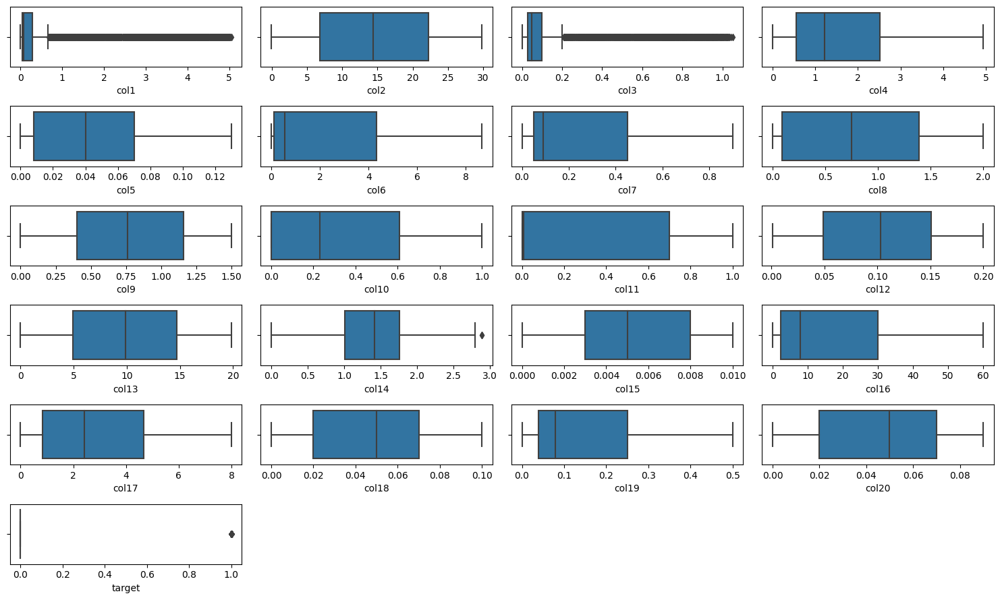

In [7]:
cols = 4
rows = 6
num_cols = df.columns
fig = plt.figure(figsize= (15,9))
for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot(rows, cols, i+1)
    
    sns.boxplot(x=df[col], ax=ax)
    
fig.tight_layout()  
plt.show()

C:\Users\crist\AppData\Local\Temp\ipykernel_22212\3317578759.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(x=df[col], ax=ax)
C:\Users\crist\AppData\Local\Temp\ipykernel_22212\3317578759.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(x=df[col], ax=ax)
C:\Users\crist\AppData\Local\Temp\

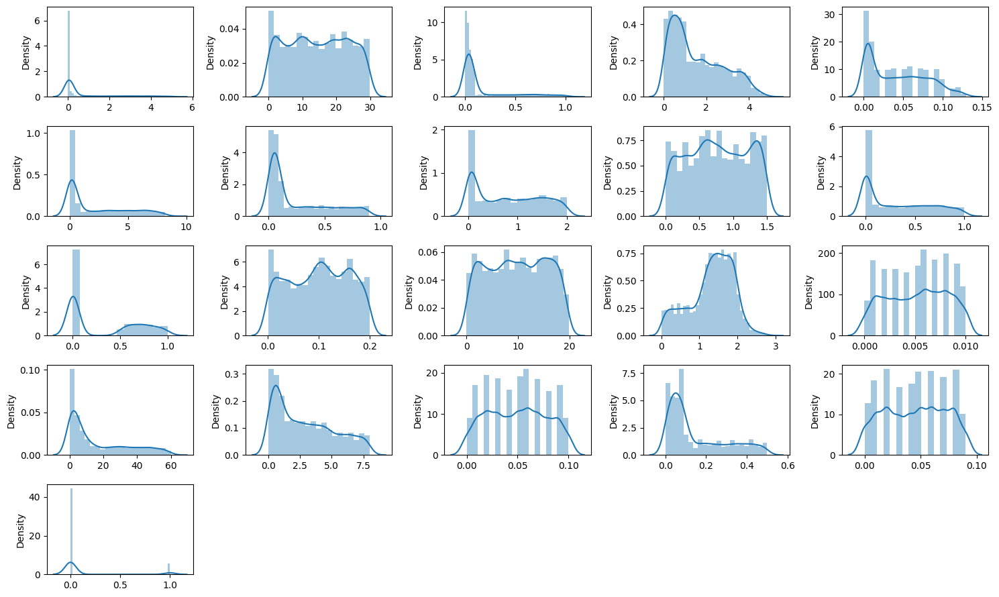

In [8]:
cols = 5
rows = 5
num_cols = df.columns
fig = plt.figure(figsize= (15,9))
for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot(rows, cols, i+1)
    
    sns.distplot(x=df[col], ax=ax)
    
fig.tight_layout()  
plt.show()

### Verificación de outliers
Elegimos aquellas columnas para las que la distribución en el boxplot podría indicar la presencia de estos datos anómalos

In [9]:
px.scatter(data_frame = df,x = 'target',y = 'col1')

In [10]:
px.scatter(data_frame = df,x = 'target',y = 'col3')

In [11]:
px.scatter(data_frame = df,x = 'target',y = 'col14')

No encontramos datos anómalos, la distribución parece bastante homogénea

### Análisis de correlación entre variables

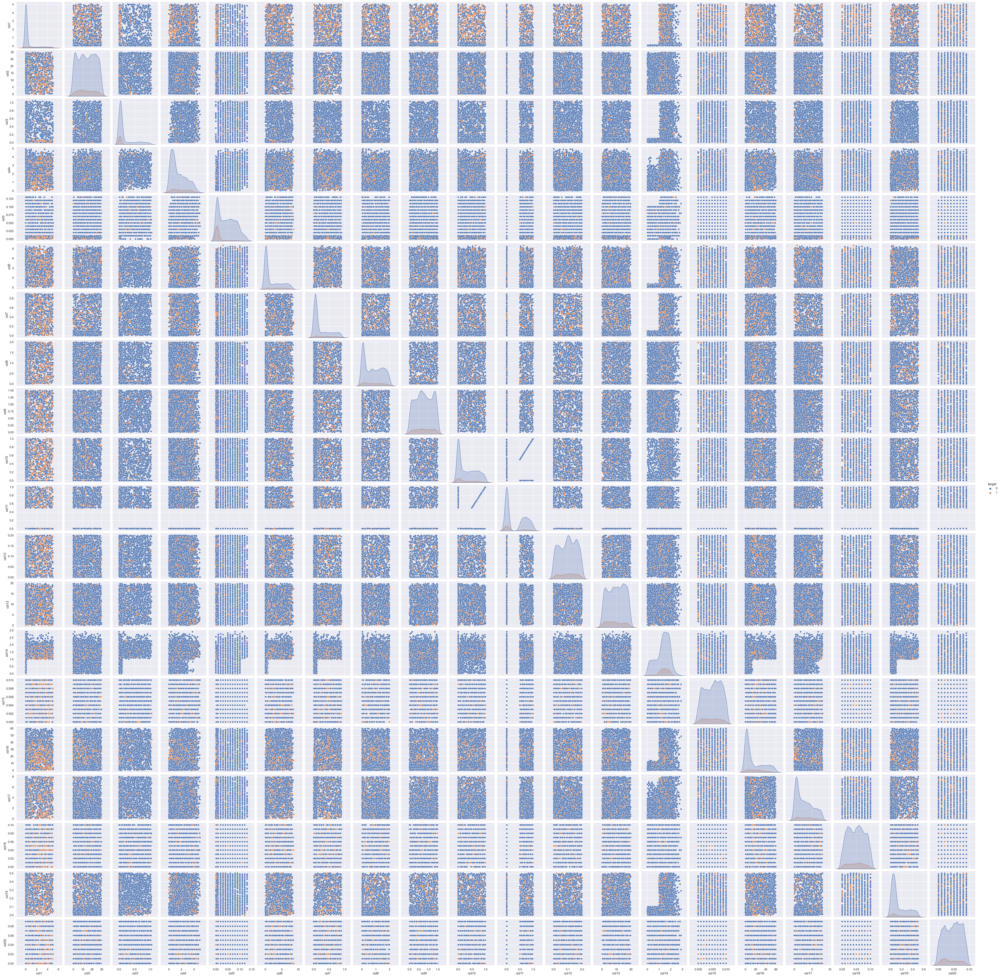

In [55]:
sns.set(rc={'figure.figsize':(20, 20)})
sns.pairplot(df,hue='target');

Evaluamos la correlación de las variables con distribución particular en mayor detalle

In [60]:
px.scatter(data_frame = df, x = 'col3', y = 'col1', color = 'target')

In [61]:
px.scatter(data_frame = df, x = 'col14', y = 'col8', color = 'target')

<Axes: >

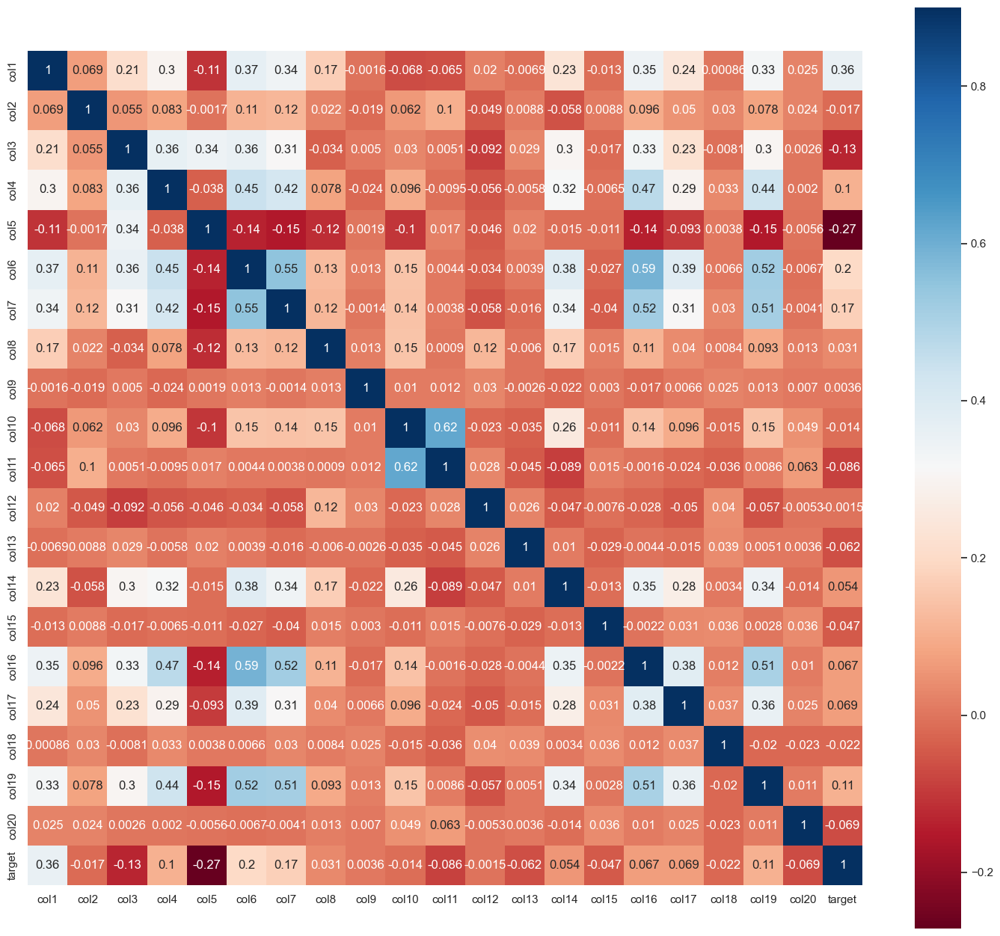

In [62]:
#Correlación entre todas las variables
corrmat = df.corr()
plt.subplots(figsize=(18,16))
sns.heatmap(corrmat, vmax=0.9, square=True, cmap = 'RdBu',annot = True)

Las variables que presentan más correlación entre sí son:
- Correlación positiva:
    1. Col10 y Col11
    2. Col6 y Col16
    3. Col6 y Col7
- Correlación negativa:
    1. Col5 y target
    2. Col5 y Col19
    3. Col5 y Col16

# Modelos evaluados y métricas

In [39]:
from sklearn import linear_model
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,  GradientBoostingClassifier
from sklearn.svm import SVC


from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve, roc_auc_score


from sklearn.model_selection import train_test_split
from sklearn import metrics


%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [15]:
X = df.iloc[:,:-1]
y = df['target']

In [16]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

#### Logistic Regression

In [30]:
logreg = linear_model.LogisticRegression(random_state=42)
logreg.fit(X,y)

logreg_predict = logreg.predict(X_test)
print('Score:', logreg.score(X, y))
print('MAE:', metrics.mean_absolute_error(y_test, logreg_predict))
print('MSE:', metrics.mean_squared_error(y_test, logreg_predict))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, logreg_predict)))
print('Accurary score:', accuracy_score(y_test,logreg_predict))

Score: 0.9033410755762016
MAE: 0.08571428571428572
MSE: 0.08571428571428572
RMSE: 0.29277002188455997
Accurary score: 0.9142857142857143


c:\Users\crist\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



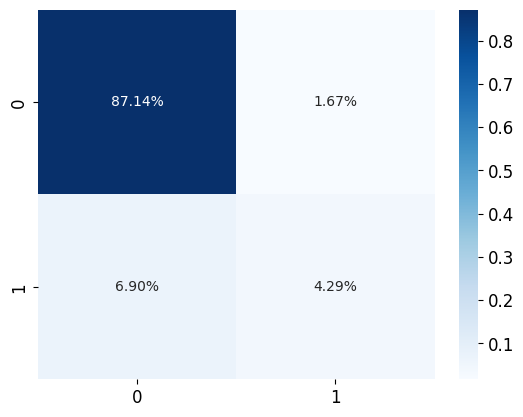

In [33]:
c_matrix = confusion_matrix(y_test, logreg_predict)
sns.heatmap(c_matrix/np.sum(c_matrix), annot=True, fmt='.2%', cmap='Blues');

c:\Users\crist\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



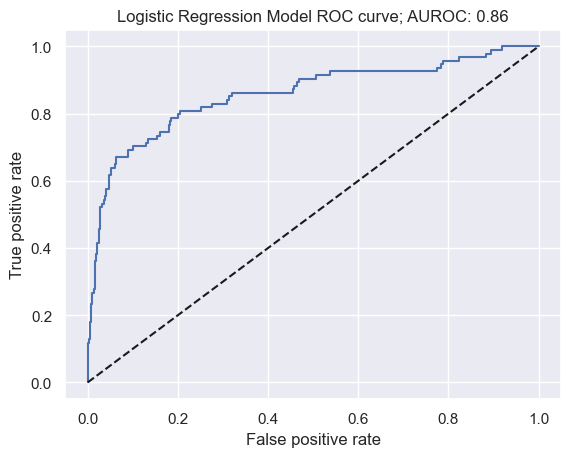

In [41]:
y_pred_proba = logreg.predict_proba(np.array(X_test))[:,1]

fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

sns.set()

plt.plot(fpr, tpr)

plt.plot(fpr, fpr, linestyle = '--', color = 'k')

plt.xlabel('False positive rate')

plt.ylabel('True positive rate')

AUROC = np.round(roc_auc_score(y_test, y_pred_proba), 2)

plt.title(f'Logistic Regression Model ROC curve; AUROC: {AUROC}');

plt.show()

#### Decision trees

In [17]:
tree_clf = DecisionTreeClassifier(max_depth=3, random_state=42)
tree_clf.fit(X, y)

tree_predic = tree_clf.predict(X_test)
print('Score:', tree_clf.score(X, y))
print('MAE:', metrics.mean_absolute_error(y_test, tree_predic))
print('MSE:', metrics.mean_squared_error(y_test, tree_predic))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, tree_predic)))
print('Accurary score:', accuracy_score(y_test,tree_predic))

Score: 0.944791852778274
MAE: 0.04642857142857143
MSE: 0.04642857142857143
RMSE: 0.21547290184283366
Accurary score: 0.9535714285714286


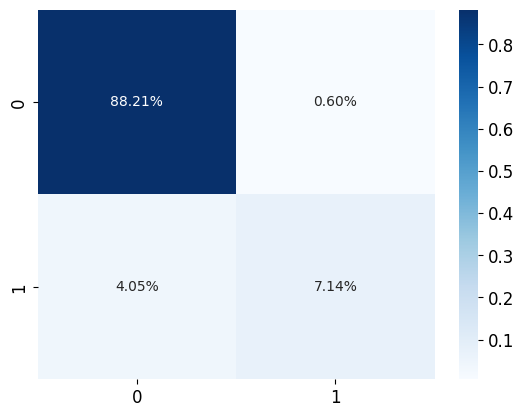

In [34]:
c_matrix = confusion_matrix(y_test, tree_predic)
sns.heatmap(c_matrix/np.sum(c_matrix), annot=True, fmt='.2%', cmap='Blues');

c:\Users\crist\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names



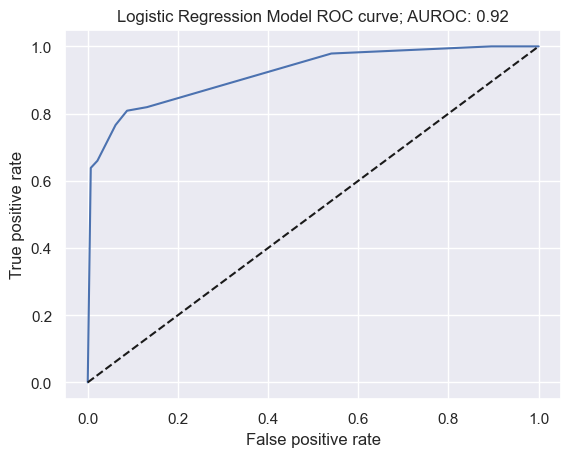

In [42]:
y_pred_proba = tree_clf.predict_proba(np.array(X_test))[:,1]

fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

sns.set()

plt.plot(fpr, tpr)

plt.plot(fpr, fpr, linestyle = '--', color = 'k')

plt.xlabel('False positive rate')

plt.ylabel('True positive rate')

AUROC = np.round(roc_auc_score(y_test, y_pred_proba), 2)

plt.title(f'Logistic Regression Model ROC curve; AUROC: {AUROC}');

plt.show()

#### Random Forest

In [18]:
rforest = RandomForestClassifier(random_state=42)
rforest.fit(X, y)

forest_predic = rforest.predict(X_test)
print('Score:', rforest.score(X, y))
print('MAE:', metrics.mean_absolute_error(y_test, forest_predic))
print('MSE:', metrics.mean_squared_error(y_test, forest_predic))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, forest_predic)))
print('Accurary score:', accuracy_score(y_test,forest_predic))

Score: 1.0
MAE: 0.0
MSE: 0.0
RMSE: 0.0
Accurary score: 1.0


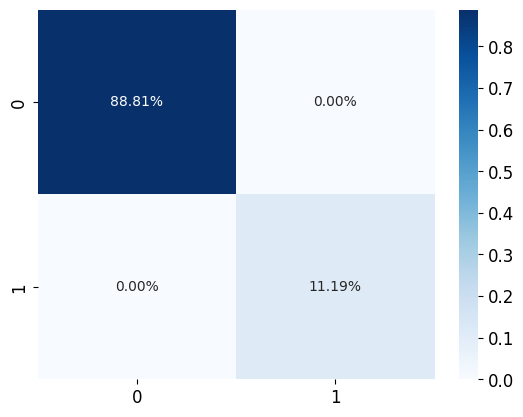

In [35]:
c_matrix = confusion_matrix(y_test, forest_predic)
sns.heatmap(c_matrix/np.sum(c_matrix), annot=True, fmt='.2%', cmap='Blues');

c:\Users\crist\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



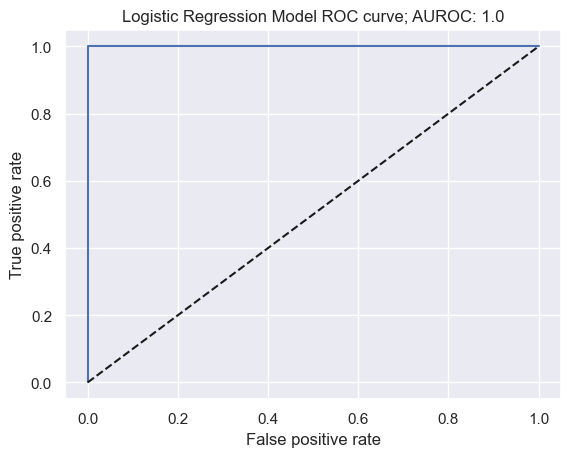

In [43]:
y_pred_proba = rforest.predict_proba(np.array(X_test))[:,1]

fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

sns.set()

plt.plot(fpr, tpr)

plt.plot(fpr, fpr, linestyle = '--', color = 'k')

plt.xlabel('False positive rate')

plt.ylabel('True positive rate')

AUROC = np.round(roc_auc_score(y_test, y_pred_proba), 2)

plt.title(f'Logistic Regression Model ROC curve; AUROC: {AUROC}');

plt.show()

Este modelo se ajusta demasiado a los datos y podría dar un overfitting.

#### Gradient Booster

In [24]:
gradboost_clf = GradientBoostingClassifier(random_state=42)
gradboost_clf.fit(X,y)

gradb_predic = gradboost_clf.predict(X_test)
print('Score:', gradboost_clf.score(X, y))
print('MAE:', metrics.mean_absolute_error(y_test, gradb_predic))
print('MSE:', metrics.mean_squared_error(y_test, gradb_predic))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, gradb_predic)))
print('Accurary score:', accuracy_score(y_test, gradb_predic))

Score: 0.9717705913882437
MAE: 0.02261904761904762
MSE: 0.02261904761904762
RMSE: 0.15039630187955957
Accurary score: 0.9773809523809524


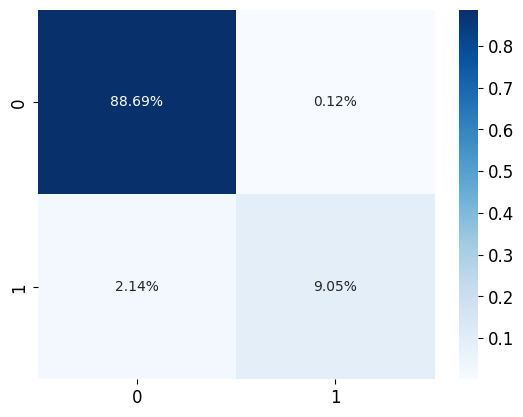

In [36]:
c_matrix = confusion_matrix(y_test, gradb_predic)
sns.heatmap(c_matrix/np.sum(c_matrix), annot=True, fmt='.2%', cmap='Blues');

c:\Users\crist\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names



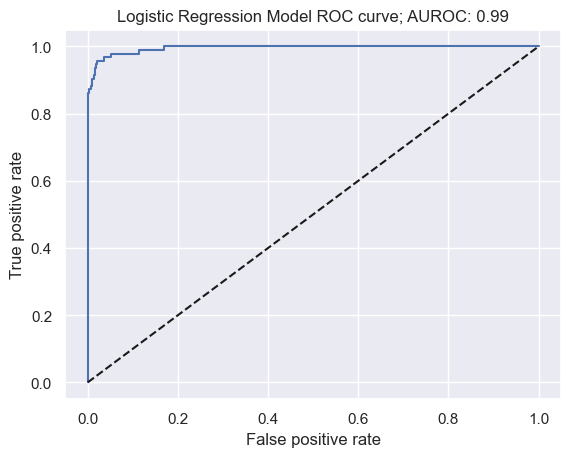

In [44]:
y_pred_proba = gradboost_clf.predict_proba(np.array(X_test))[:,1]

fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

sns.set()

plt.plot(fpr, tpr)

plt.plot(fpr, fpr, linestyle = '--', color = 'k')

plt.xlabel('False positive rate')

plt.ylabel('True positive rate')

AUROC = np.round(roc_auc_score(y_test, y_pred_proba), 2)

plt.title(f'Logistic Regression Model ROC curve; AUROC: {AUROC}');

plt.show()

#### SVM

In [106]:
svm_clf = SVC(kernel='linear', C = float(9999999999999999999))
svm_clf.fit(X,y)

svm_predic = svm_clf.predict(X_test)
print('Score:', svm_clf.score(X, y))
print('MAE:', metrics.mean_absolute_error(y_test, svm_predic))
print('MSE:', metrics.mean_squared_error(y_test, svm_predic))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, svm_predic)))
print('Accurary score:', accuracy_score(y_test,svm_predic))

### CONCLUSIONES:
Según score y accuracy (precisión), el mejor modelo sería el GradientBooster, por lo que lo usaríamos a partir de ahora. La matriz de confusión nos permite visualizar que este algoritmo produce un 0.12% de Falsos Positivos y un 2.14% de Falsos Negativos.

# Predicción

In [19]:
df_test = pd.read_csv("data/test.csv")
df_test.head()

,ID,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col11,col12,col13,col14,col15,col16,col17,col18,col19,col20
0,2816,0.06,25.18,0.04,0.04,0.001,5.10,0.86,1.23,0.52,...,0.620,0.022,12.63,1.93,0.003,1.19,7.79,0.04,0.43,0.01
1,3641,0.09,27.51,0.63,2.05,0.110,6.81,0.83,0.09,1.21,...,0.730,0.001,4.49,1.95,0.009,52.30,1.00,0.10,0.12,0.01
2,7191,0.09,1.10,0.07,0.73,0.050,0.10,0.01,1.44,1.42,...,0.007,0.177,1.03,1.27,0.002,7.04,0.38,0.06,0.05,0.06
3,5199,0.07,11.23,0.04,1.22,0.030,0.16,0.03,1.18,0.88,...,0.001,0.032,4.07,0.98,0.003,1.28,0.51,0.06,0.03,0.07
4,7994,0.01,10.00,0.01,2.00,0.000,2.00,0.00,0.09,0.00,...,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.00,0.00,0.00


In [20]:
df_test.shape

(2399, 21)

In [21]:
df_test.set_index('ID', inplace = True)

In [25]:
predictions_test = gradboost_clf.predict(df_test)
predictions_test

array([0, 0, 0, ..., 0, 0, 1], dtype=int64)